In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os, pickle
import sys
from skimage import io
import os

sys.path.append("../../")


%load_ext autoreload
%autoreload 2
%matplotlib inline

In [9]:
data_dir = '/nadeem_lab/Gunjan/data/impartial/Vectra1CH/' ## This should be the file where the .npz files are

pd_file = pd.read_csv(data_dir + 'files.csv')
pd_file.to_csv(data_dir + 'files.csv')

print(pd_file) 
print()

#get number of instances per segmentation class
for i in range(len(pd_file)):
    group = pd_file['group'][i]
    print( data_dir + pd_file['input_file'][i])
    npz_read = np.load(data_dir + pd_file['input_file'][i])
    image = npz_read['image']        
    label = npz_read['label']
    print("label shape", label.shape)
    #initialize lists
    if i == 0:
        if len(label.shape)>2:
            nclasses = label.shape[-1]
        else:
            nclasses = 1
        nlabels_class_train_list = [0 for i in range(nclasses)]
        nlabels_class_test_list = [0 for i in range(nclasses)]
    
    if len(label.shape)>2:
        for ix in range(label.shape[-1]):
            if group == 'train':
                nlabels_class_train_list[ix] += np.unique(label[...,ix]).shape[0] - 1
            else:
                nlabels_class_test_list[ix] += np.unique(label[...,ix]).shape[0] - 1
    else: #only one class
        if group == 'train':
            nlabels_class_train_list[0] += np.unique(label).shape[0] - 1
        else:
            nlabels_class_test_list[0] += np.unique(label).shape[0] - 1
        

print()
print('----')
print('total train instances per class (',nclasses, 'classes)')
print(nlabels_class_train_list)
print('total test instances per class (',nclasses, 'classes)')
print(nlabels_class_test_list)

    Unnamed: 0    prefix    input_file  group
0            0   image_0   image_0.npz  train
1            1   image_1   image_1.npz  train
2            2   image_2   image_2.npz  train
3            3   image_3   image_3.npz  train
4            4   image_4   image_4.npz  train
5            5   image_5   image_5.npz  train
6            6   image_6   image_6.npz  train
7            7   image_7   image_7.npz  train
8            8   image_8   image_8.npz  train
9            9   image_9   image_9.npz  train
10          10  image_10  image_10.npz  train
11          11  image_11  image_11.npz  train
12          12  image_12  image_12.npz  train
13          13  image_13  image_13.npz  train
14          14  image_14  image_14.npz  train
15          15  image_15  image_15.npz  train
16          16  image_16  image_16.npz  train
17          17  image_17  image_17.npz  train
18          18  image_18  image_18.npz  train
19          19  image_19  image_19.npz  train
20          20  image_20  image_20

In [10]:
from skimage import morphology

def erosion_labels(label,radius_pointer=1): 
    #needed to generate scribbles from boundaries since in many cases 
    #there is no background between different instances
    selem = morphology.disk(radius_pointer)
    mask = np.zeros_like(label)
    for vlabel in np.unique(label):
        if vlabel != 0:
            mask_label = np.zeros_like(label)
            mask_label[label == vlabel] = 1
            aux = morphology.dilation(mask_label, selem=selem)
            if np.unique(aux*label).shape[0] > 2: #overlaps with other label
                erode_label = morphology.erosion(mask_label, selem=selem)
                mask[erode_label>0] = vlabel
            else:
                mask[mask_label>0] = vlabel
    ## Image Corners
    mask[:,0:radius_pointer] = label[:,0:radius_pointer]
    mask[:,-radius_pointer-1:] = label[:,-radius_pointer-1:]
    mask[0:radius_pointer,:] = label[0:radius_pointer,:]
    mask[-radius_pointer-1:,:] = label[-radius_pointer-1:,:]
    return mask

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_0.npz


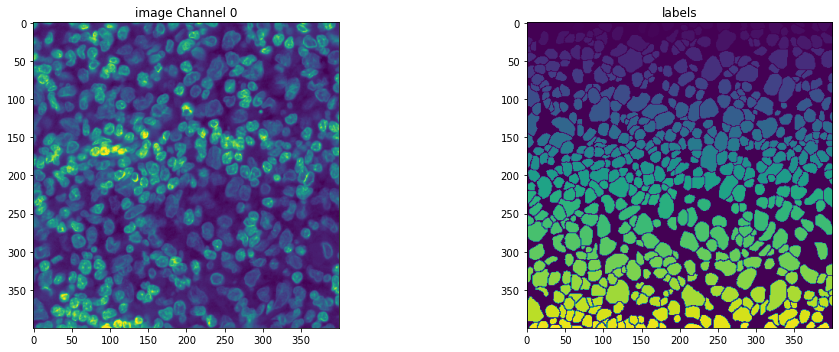

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_1.npz


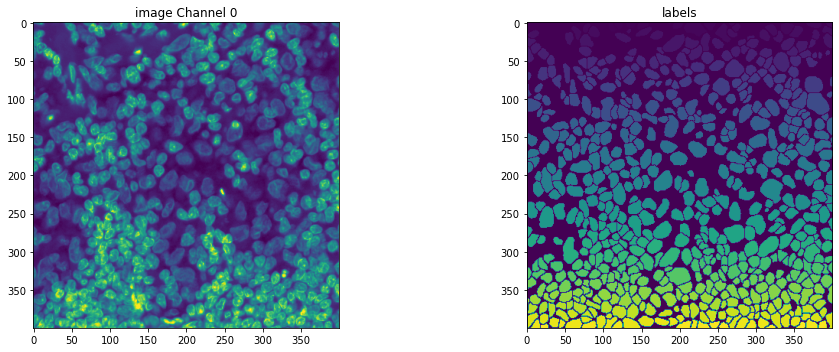

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_2.npz


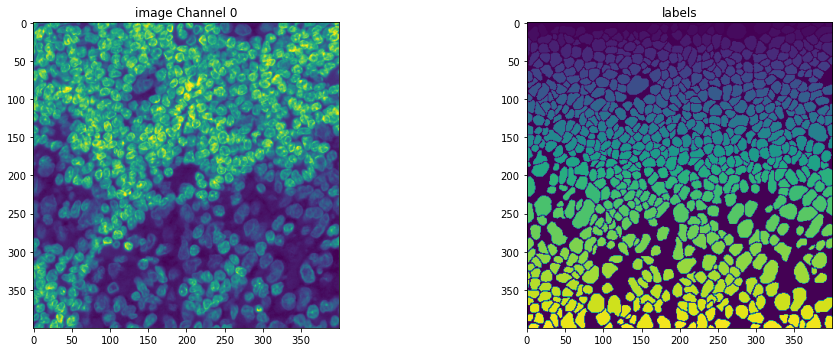

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_3.npz


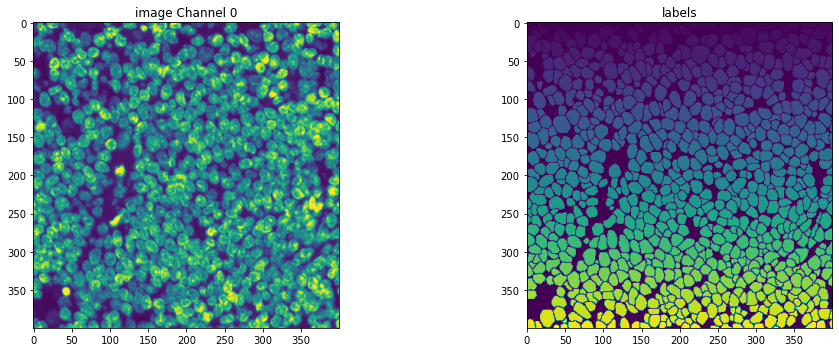

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_4.npz


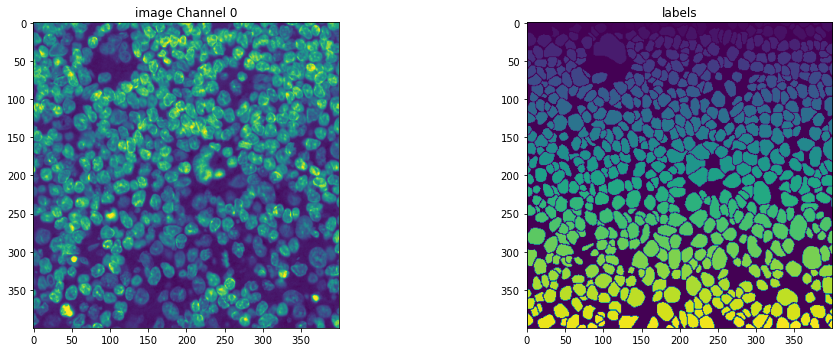

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_5.npz


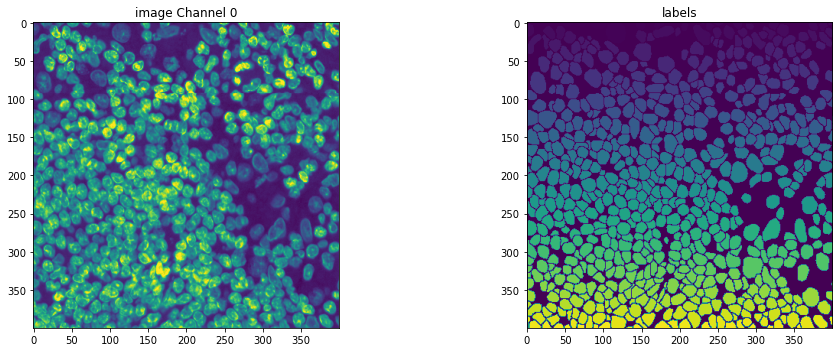

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_6.npz


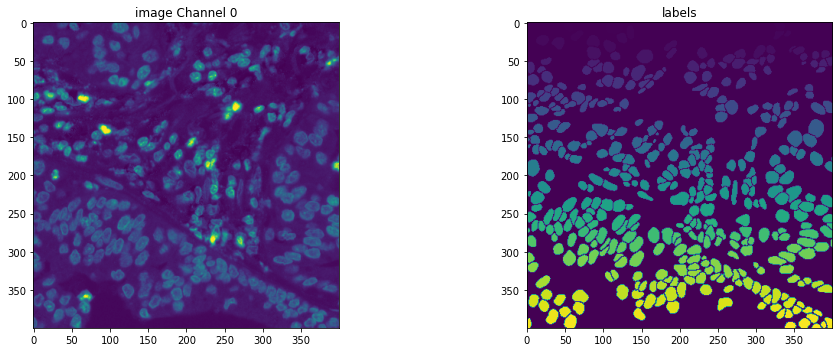

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_7.npz


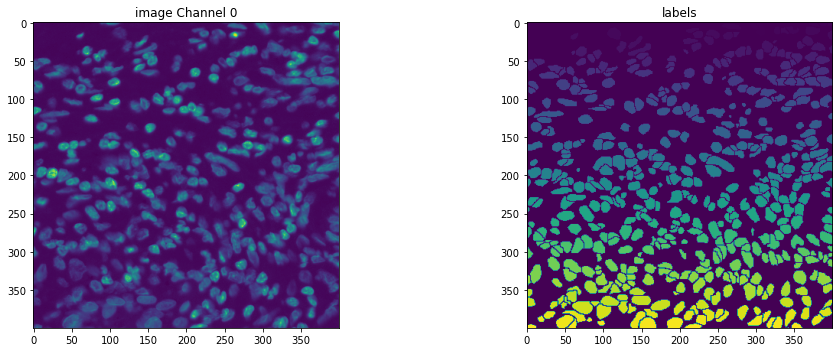

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_8.npz


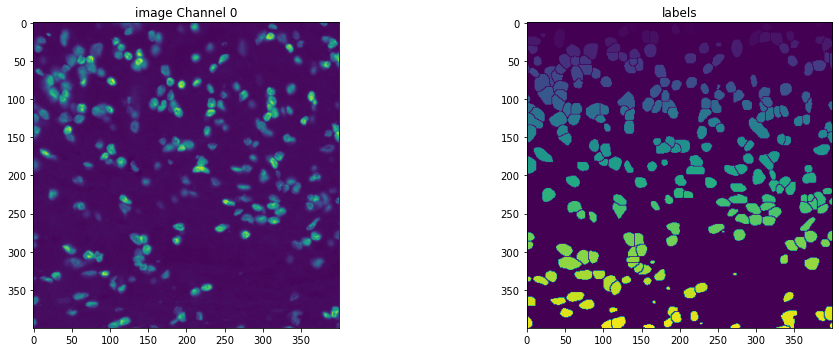

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_9.npz


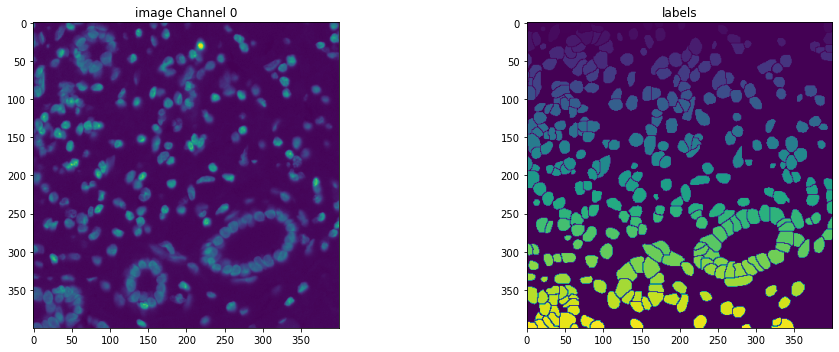

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_10.npz


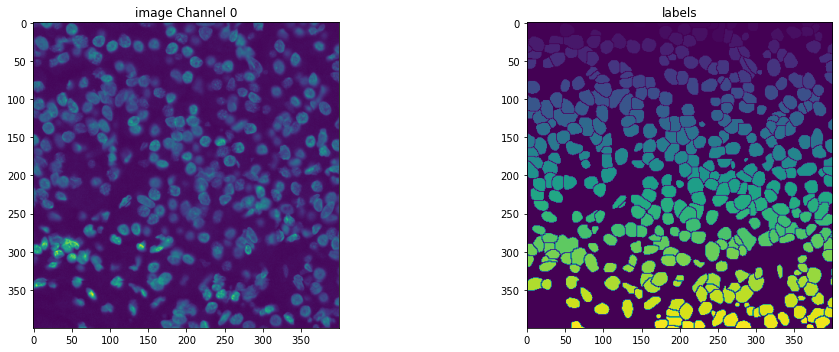

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_11.npz


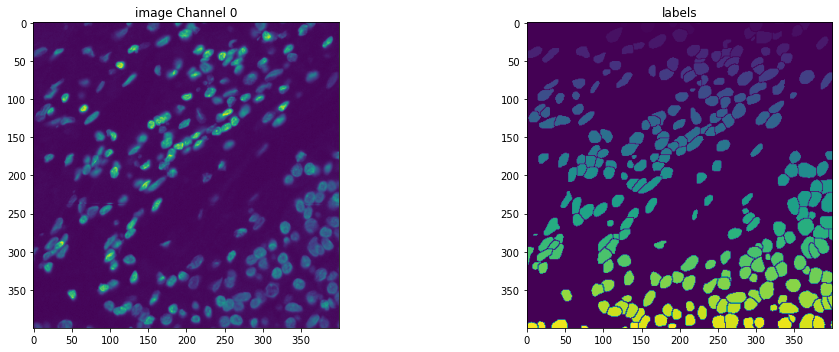

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_12.npz


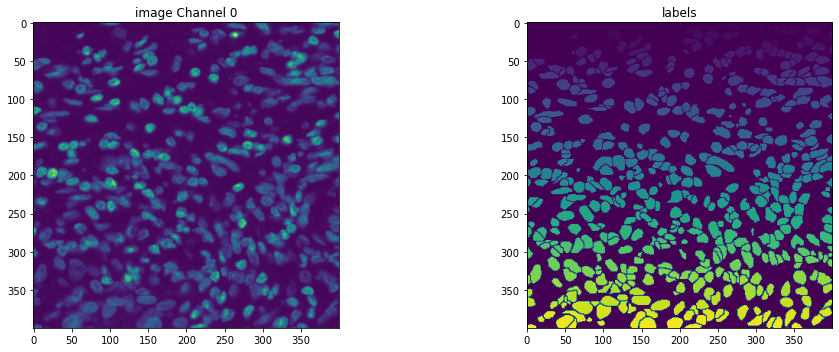

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_13.npz


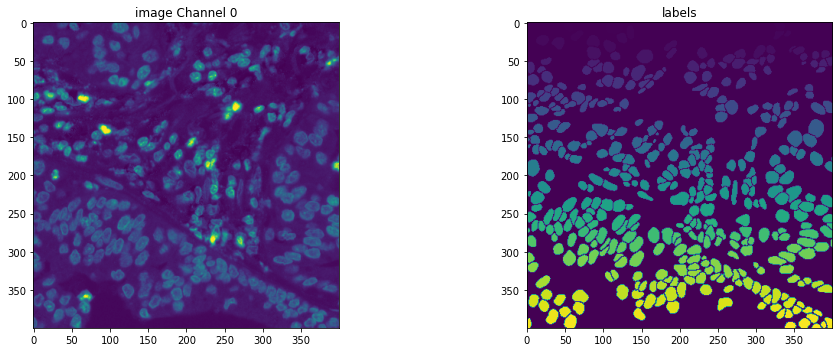

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_14.npz


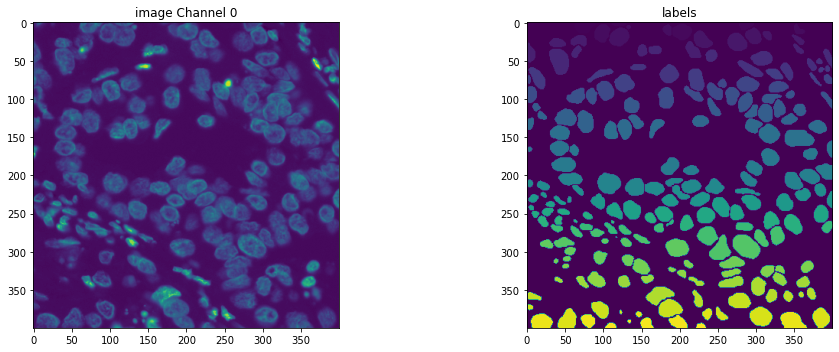

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_15.npz


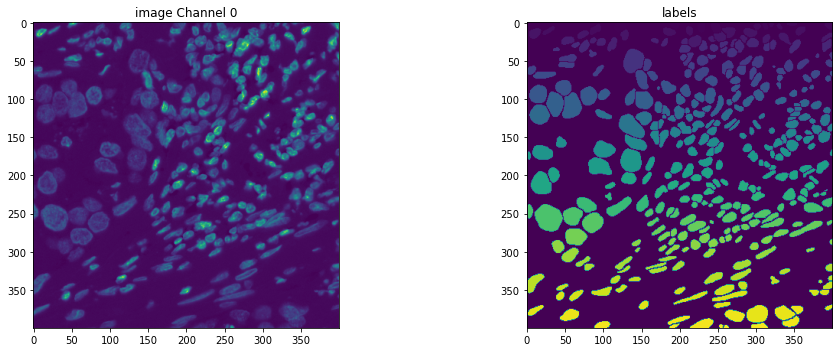

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_16.npz


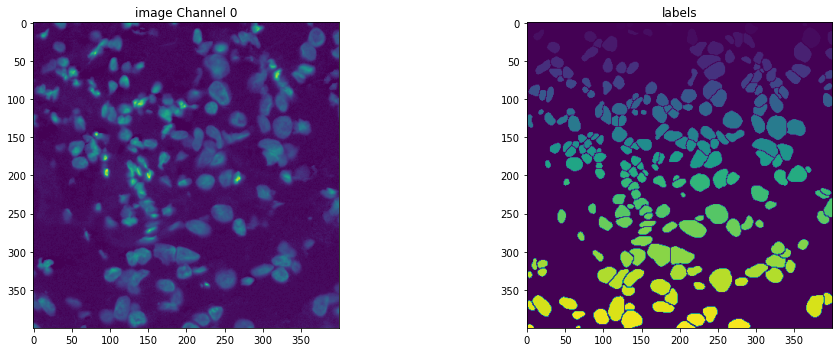

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_17.npz


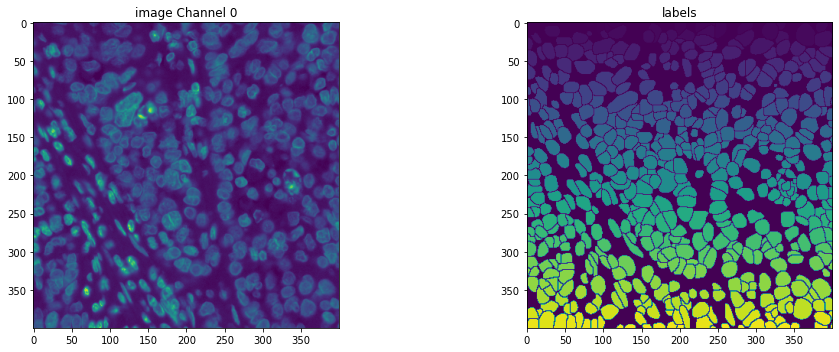

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_18.npz


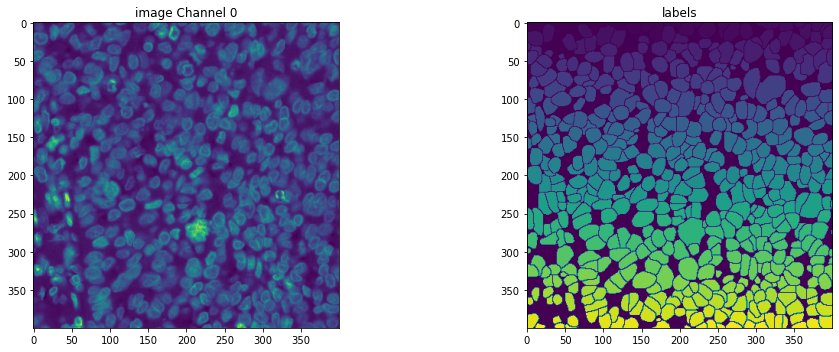

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_19.npz


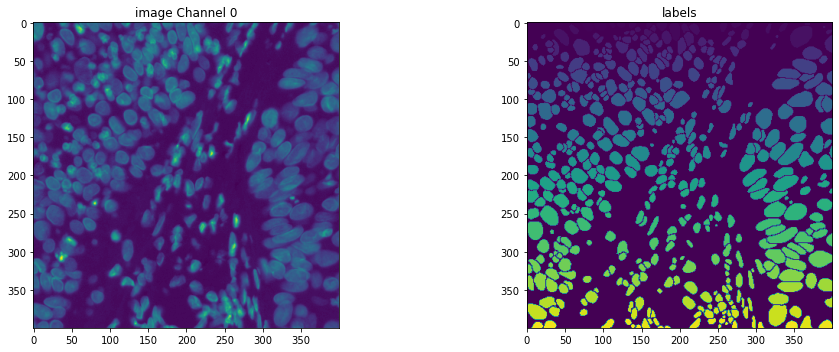

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_20.npz


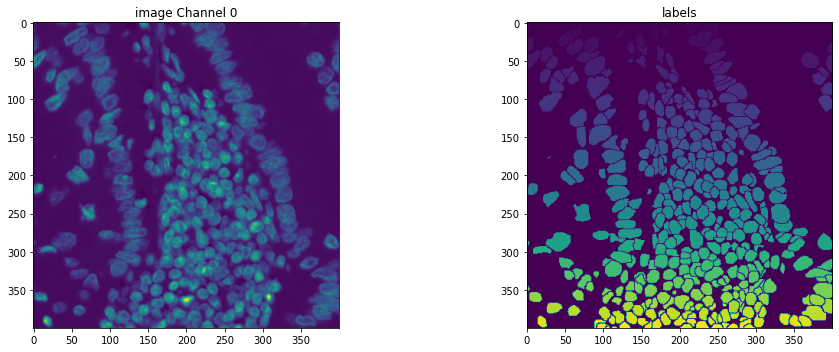

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_21.npz


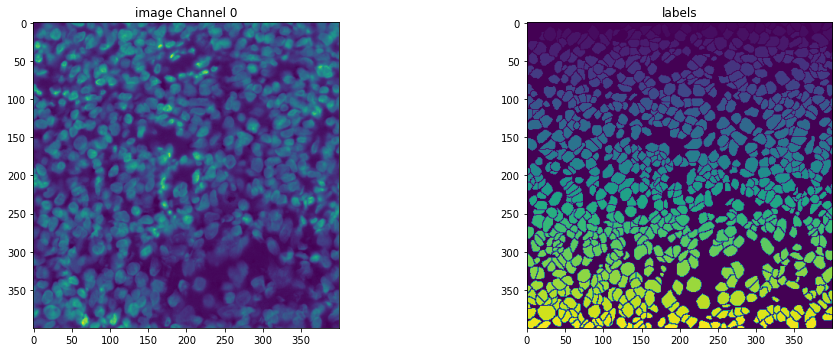

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_22.npz


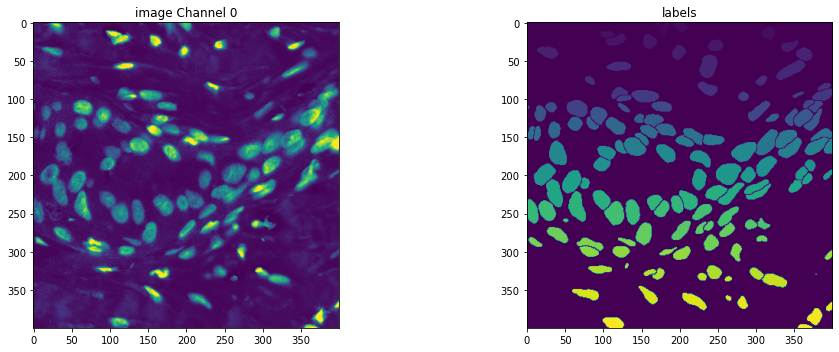

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_23.npz


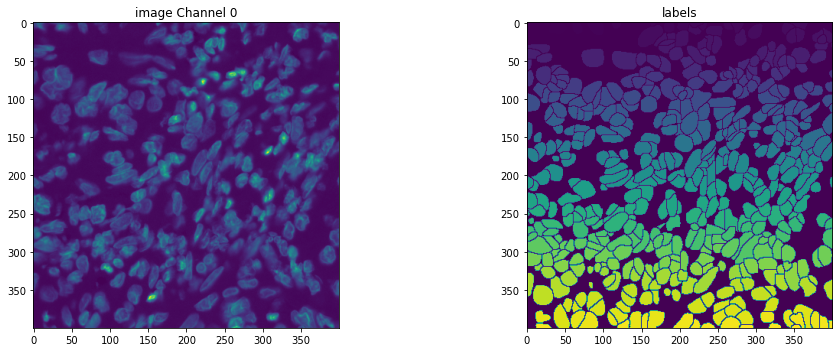

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_24.npz


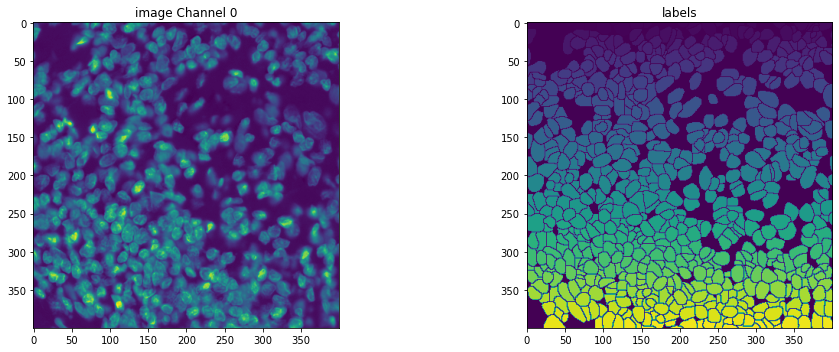

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_25.npz


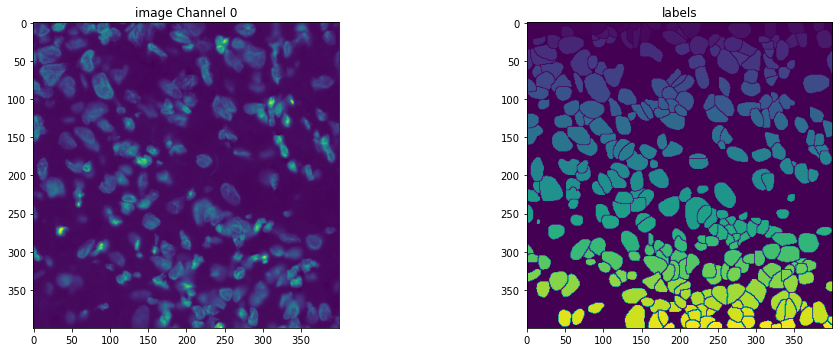

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_26.npz


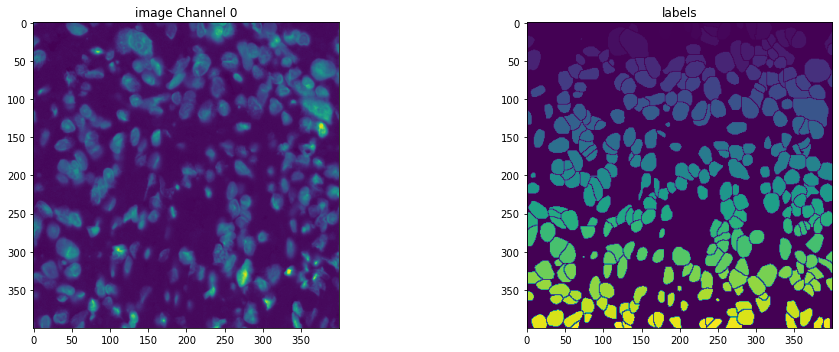

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_27.npz


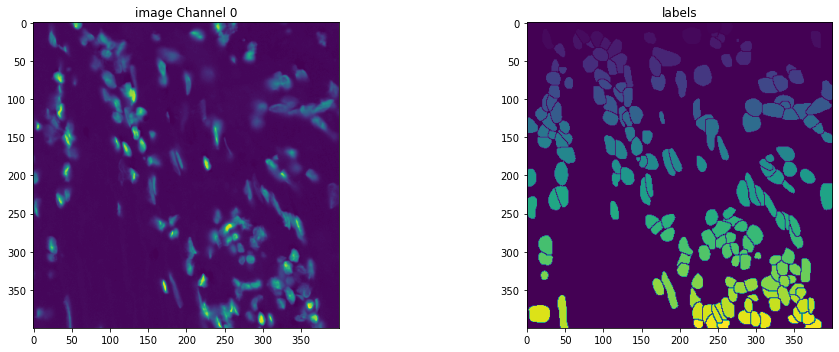

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_28.npz


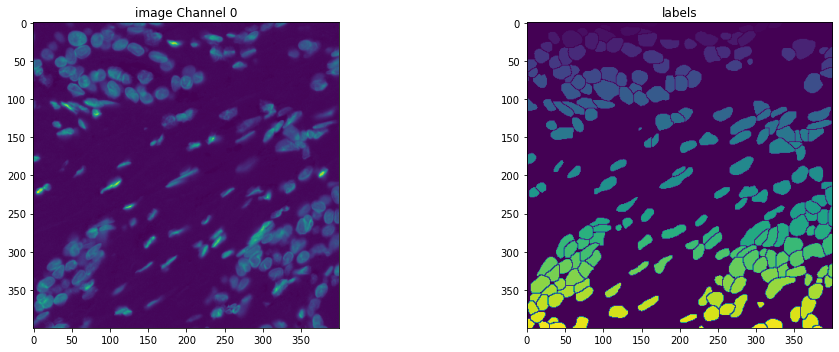

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_29.npz


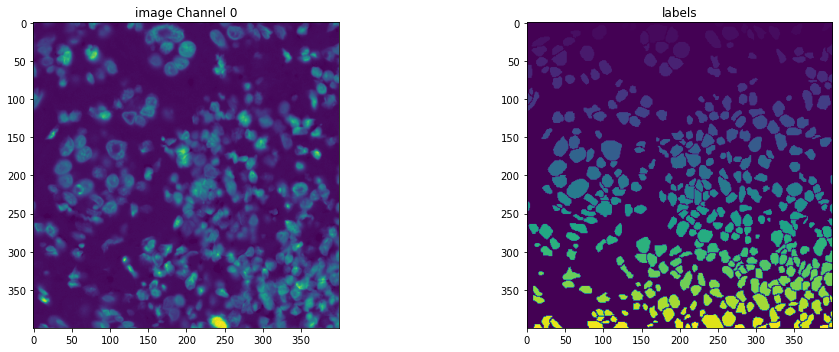

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_30.npz


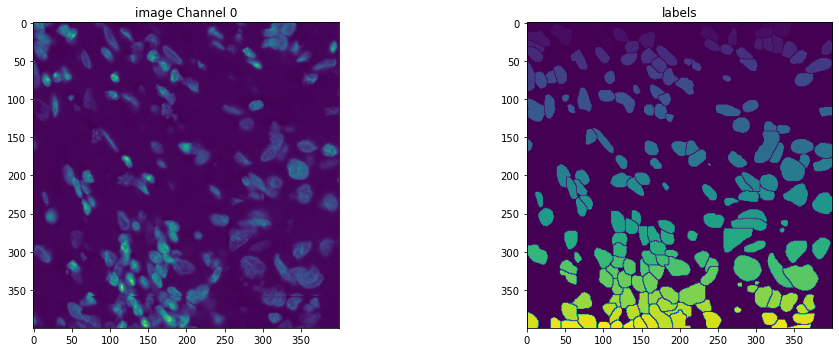

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_31.npz


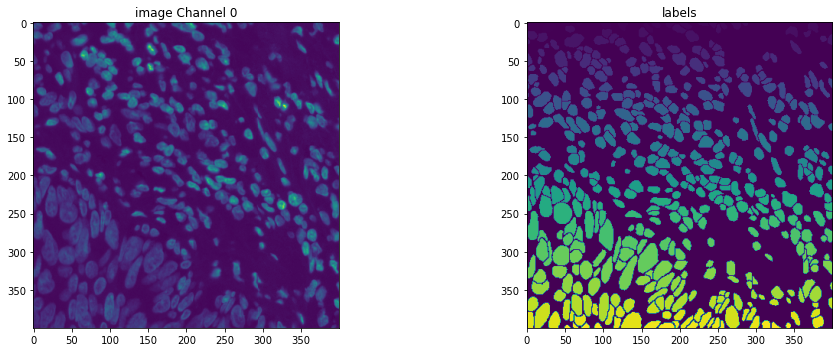

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_32.npz


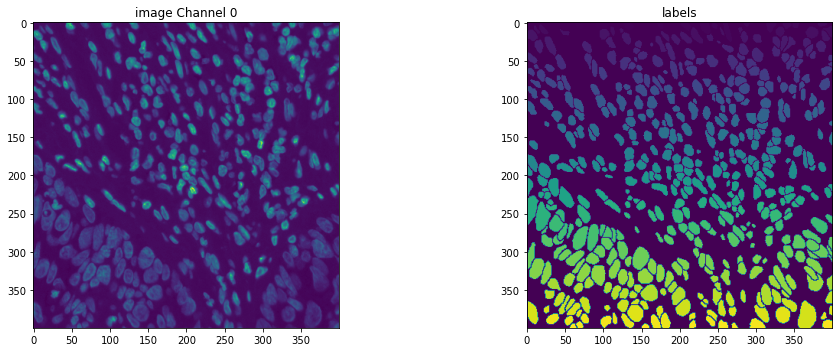

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_33.npz


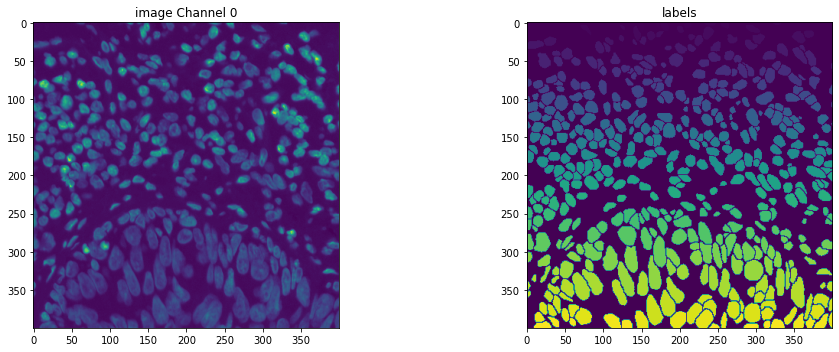

/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_34.npz


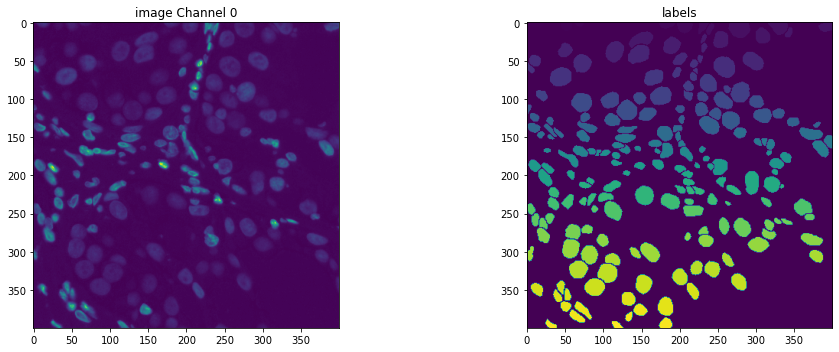

In [11]:
from dataprocessing.labelgeneration import get_scribbles

#load train segmentations in a list
X_train_list = []

Y_gt_train_ch0_list = []

files_train_list_aux = []

nlabels_total0 = 0

for i in range(len(pd_file)):
    group = pd_file['group'][i]
    if group == 'train':

        print( data_dir + pd_file['input_file'][i])
        npz_read = np.load(data_dir + pd_file['input_file'][i])
        image = npz_read['image']        
        label0 = npz_read['label']
        label0 = erosion_labels(label0,radius_pointer=1)
        nlabels_total0 += np.unique(label0).shape[0]-1
        
        X_train_list.append(image)
        Y_gt_train_ch0_list.append(label0)
        
        files_train_list_aux.append([data_dir,
                                 pd_file['input_file'][i],
                                 pd_file['prefix'][i],])

        plt.figure(figsize=(15,5))
        
        plt.subplot(1,2,1)
        plt.title('image Channel 0')
        plt.imshow(image)
        
             
        plt.subplot(1,2,2)
        plt.title('labels')
        plt.imshow(label0)
        
        plt.tight_layout()
        plt.show()

In [12]:
Y_out_ch0_list = []
nscribbles_ch0_list = []
nlabels_ch0_list = []

for ix in range(len(Y_gt_train_ch0_list)):
    scribbles = np.zeros([Y_gt_train_ch0_list[ix].shape[0],Y_gt_train_ch0_list[ix].shape[1],2])
    
    
    labels = np.array(Y_gt_train_ch0_list[ix])
    foreground = np.zeros_like(labels)
    foreground[labels>0] = 1
    scribbles[:,:,0] = foreground
    
    background = np.zeros_like(labels)
    background[labels==0] = 1
    scribbles[:,:,1] = background
    
    Y_out_ch0_list.append(scribbles)
    nscribbles_ch0_list.append(np.unique(labels).shape[0]-1)
    nlabels_ch0_list.append(np.unique(labels).shape[0]-1)
    

0 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_0.npz', 'image_0']
image_0_1task1class_35images_fulllabels.npz
100784 251 384
91 251 224 384
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_0_1task1class_35images_fulllabels.npz


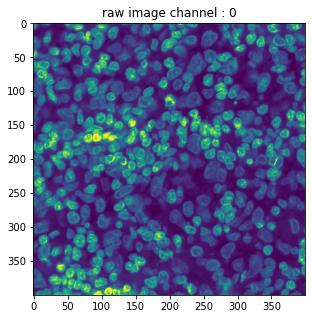

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


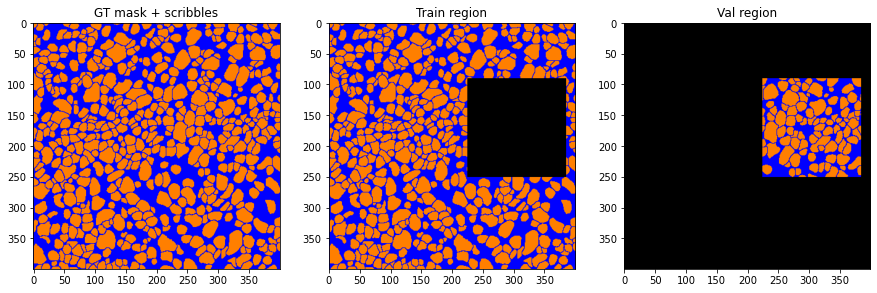

1 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_1.npz', 'image_1']
image_1_1task1class_35images_fulllabels.npz
124209 310 209
150 310 49 209
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_1_1task1class_35images_fulllabels.npz


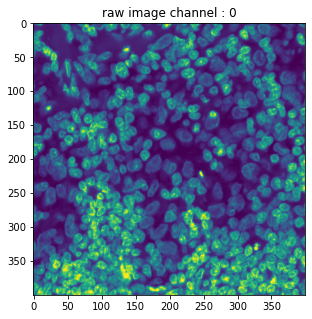

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


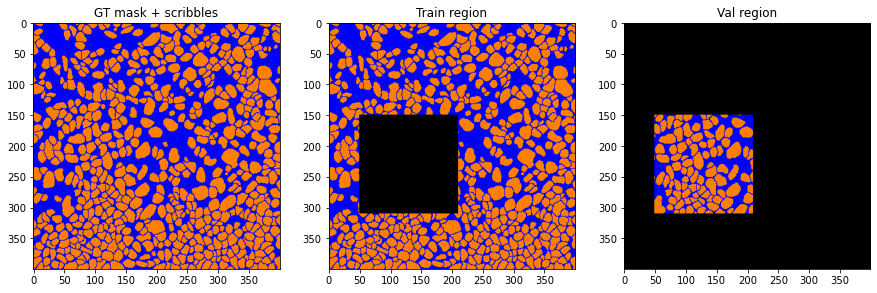

2 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_2.npz', 'image_2']
image_2_1task1class_35images_fulllabels.npz
38041 95 41
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_2_1task1class_35images_fulllabels.npz


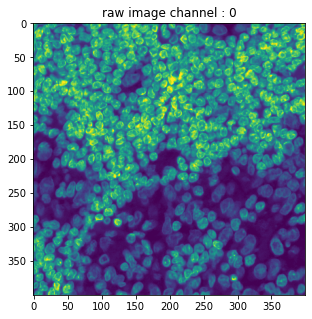

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


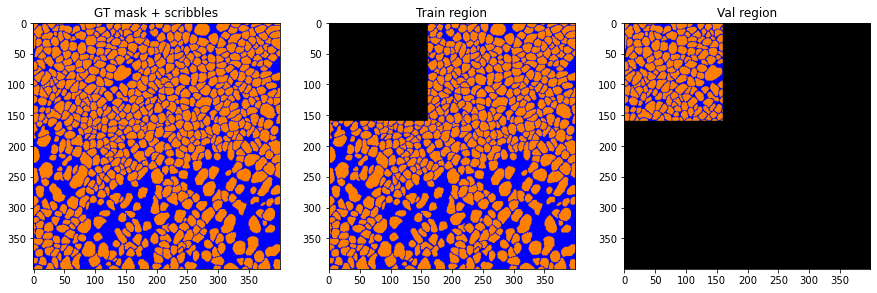

3 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_3.npz', 'image_3']
image_3_1task1class_35images_fulllabels.npz
46495 116 95
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_3_1task1class_35images_fulllabels.npz


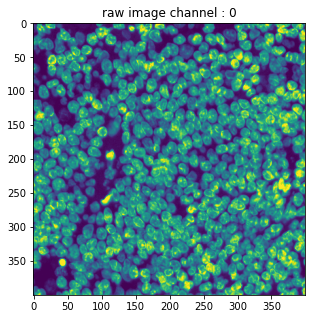

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


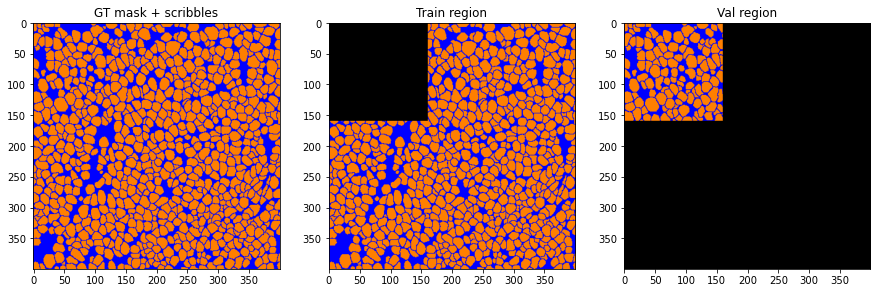

4 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_4.npz', 'image_4']
image_4_1task1class_35images_fulllabels.npz
97248 243 48
83 243 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_4_1task1class_35images_fulllabels.npz


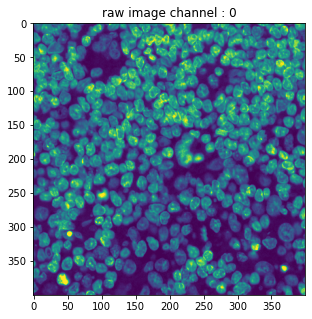

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


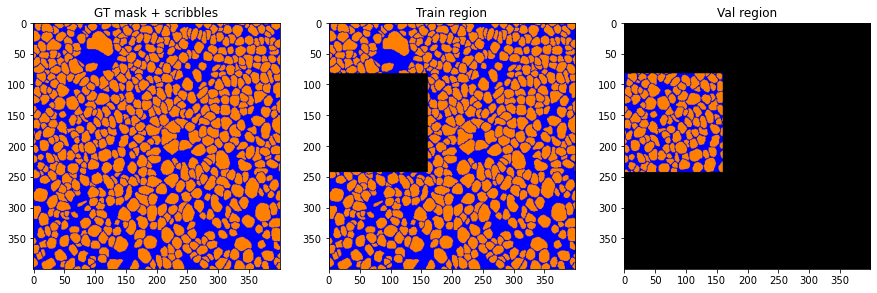

5 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_5.npz', 'image_5']
image_5_1task1class_35images_fulllabels.npz
77703 194 103
34 194 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_5_1task1class_35images_fulllabels.npz


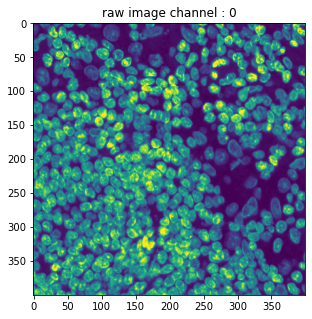

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


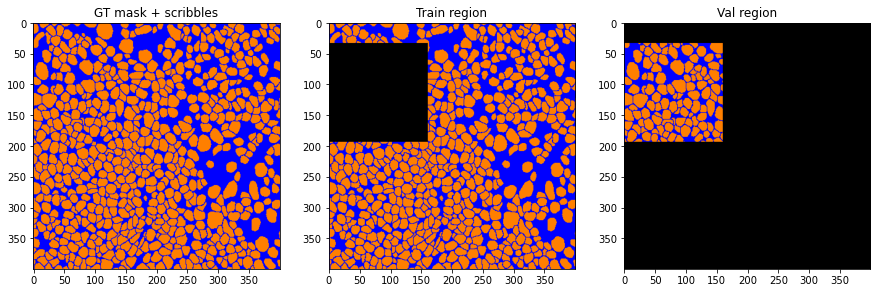

6 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_6.npz', 'image_6']
image_6_1task1class_35images_fulllabels.npz
157667 394 67
234 394 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_6_1task1class_35images_fulllabels.npz


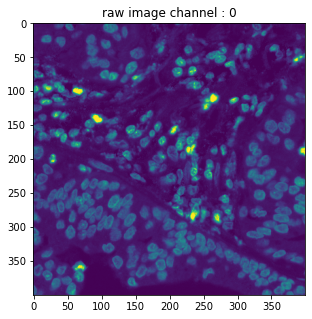

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


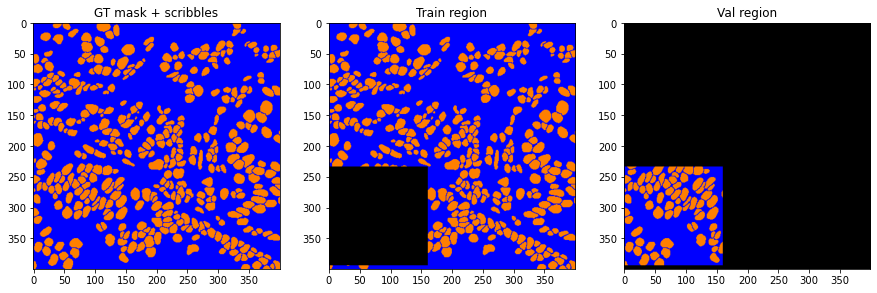

7 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_7.npz', 'image_7']
image_7_1task1class_35images_fulllabels.npz
4306 10 306
0 160 146 306
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_7_1task1class_35images_fulllabels.npz


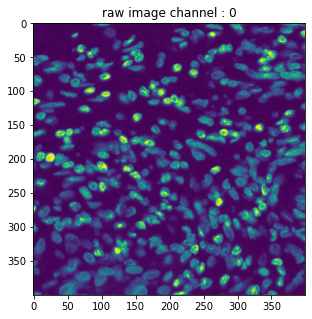

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


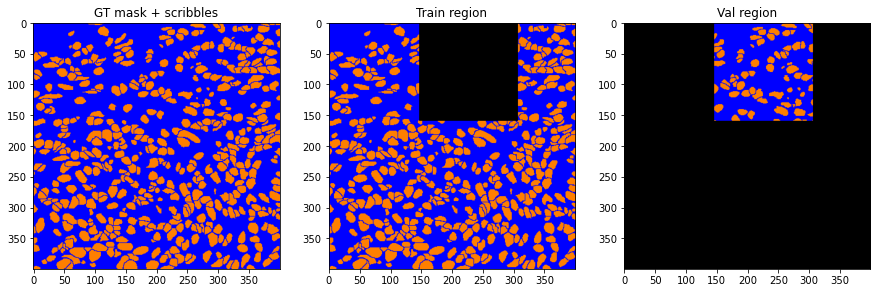

8 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_8.npz', 'image_8']
image_8_1task1class_35images_fulllabels.npz
87377 218 177
58 218 17 177
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_8_1task1class_35images_fulllabels.npz


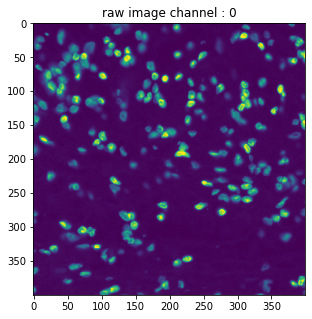

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


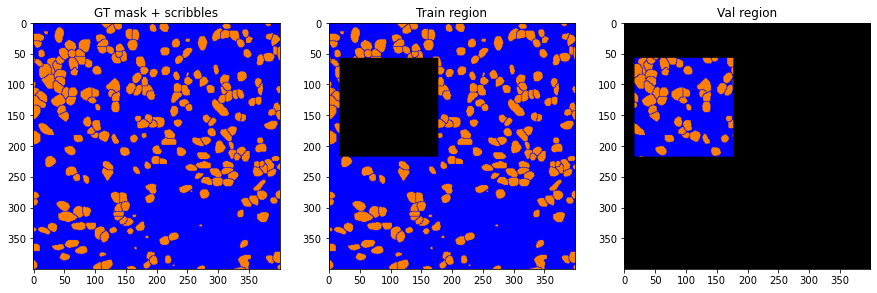

9 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_9.npz', 'image_9']
image_9_1task1class_35images_fulllabels.npz
30208 75 208
0 160 48 208
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_9_1task1class_35images_fulllabels.npz


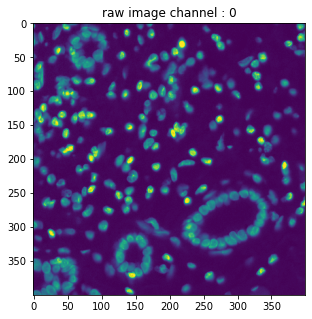

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


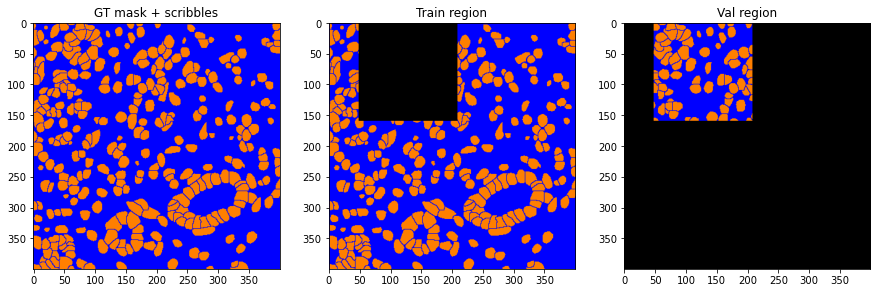

10 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_10.npz', 'image_10']
image_10_1task1class_35images_fulllabels.npz
9922 24 322
0 160 162 322
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_10_1task1class_35images_fulllabels.npz


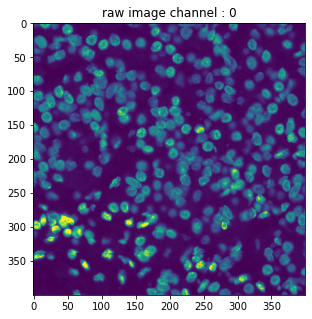

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


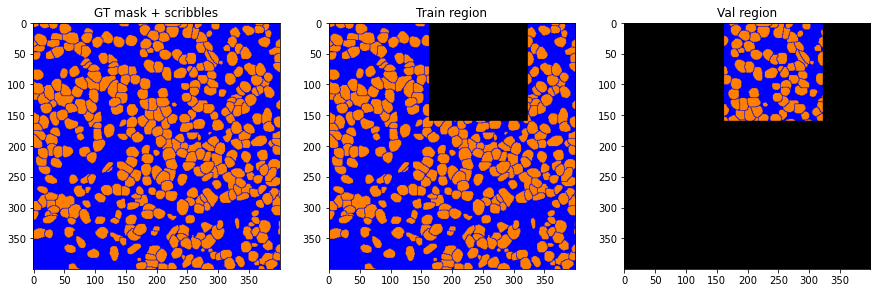

11 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_11.npz', 'image_11']
image_11_1task1class_35images_fulllabels.npz
92903 232 103
72 232 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_11_1task1class_35images_fulllabels.npz


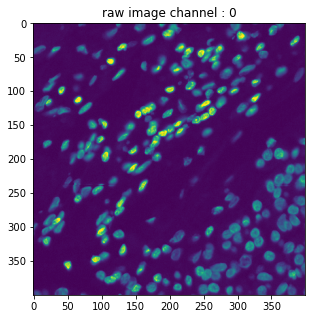

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


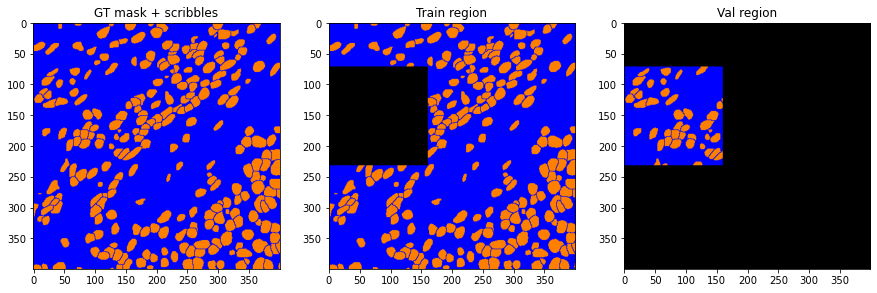

12 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_12.npz', 'image_12']
image_12_1task1class_35images_fulllabels.npz
129152 322 352
162 322 192 352
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_12_1task1class_35images_fulllabels.npz


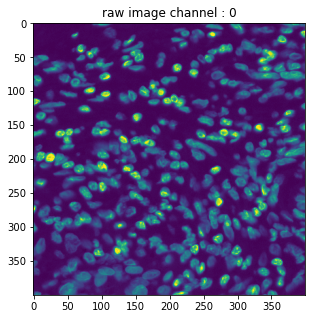

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


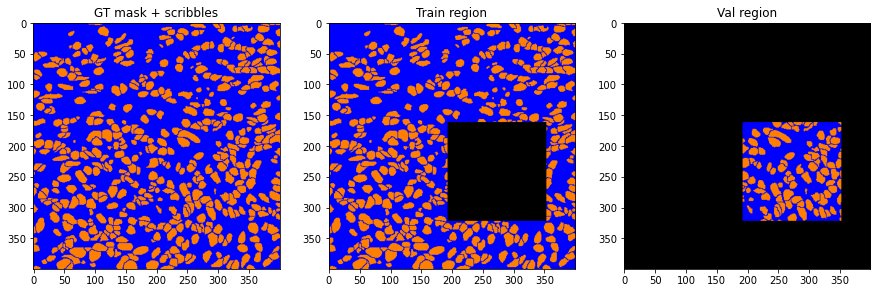

13 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_13.npz', 'image_13']
image_13_1task1class_35images_fulllabels.npz
16019 40 19
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_13_1task1class_35images_fulllabels.npz


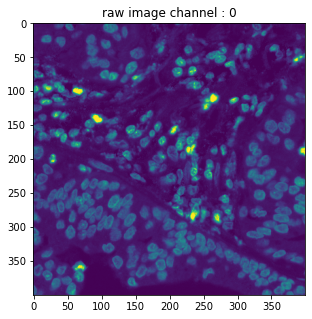

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


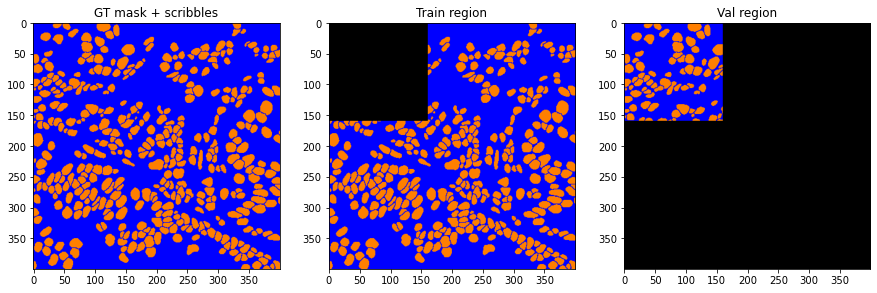

14 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_14.npz', 'image_14']
image_14_1task1class_35images_fulllabels.npz
8020 20 20
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_14_1task1class_35images_fulllabels.npz


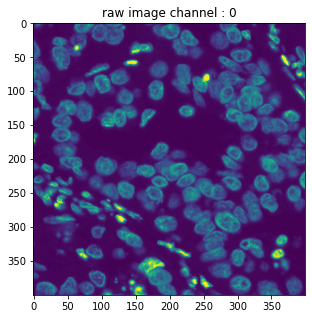

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


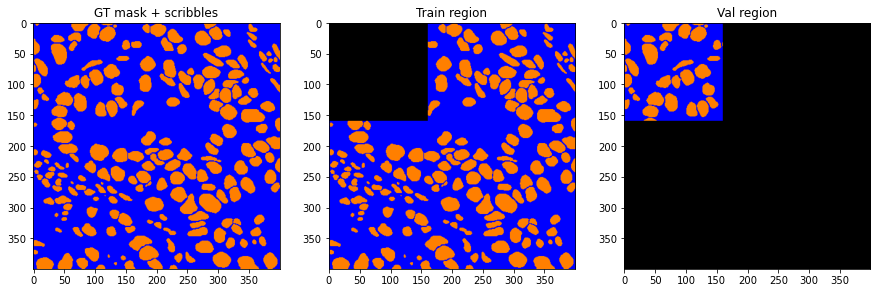

15 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_15.npz', 'image_15']
image_15_1task1class_35images_fulllabels.npz
75002 187 202
27 187 42 202
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_15_1task1class_35images_fulllabels.npz


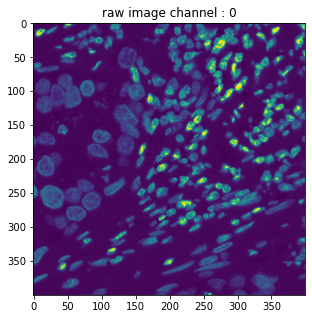

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


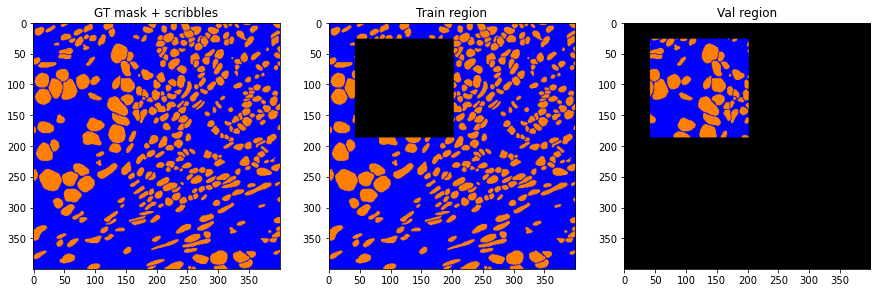

16 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_16.npz', 'image_16']
image_16_1task1class_35images_fulllabels.npz
12496 31 96
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_16_1task1class_35images_fulllabels.npz


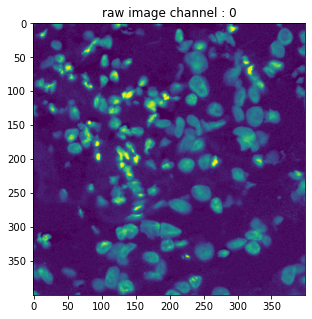

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


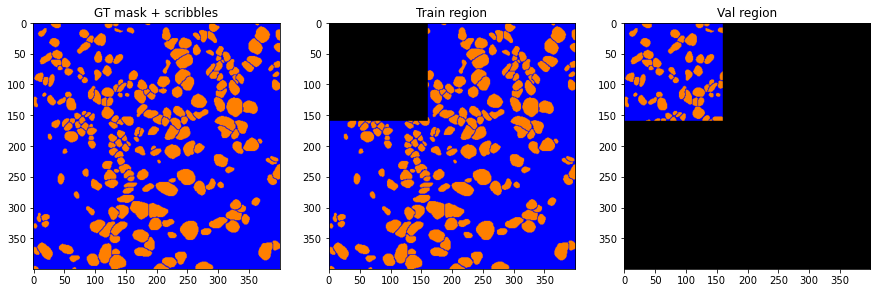

17 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_17.npz', 'image_17']
image_17_1task1class_35images_fulllabels.npz
36760 91 360
0 160 200 360
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_17_1task1class_35images_fulllabels.npz


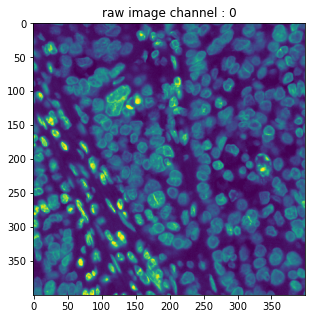

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


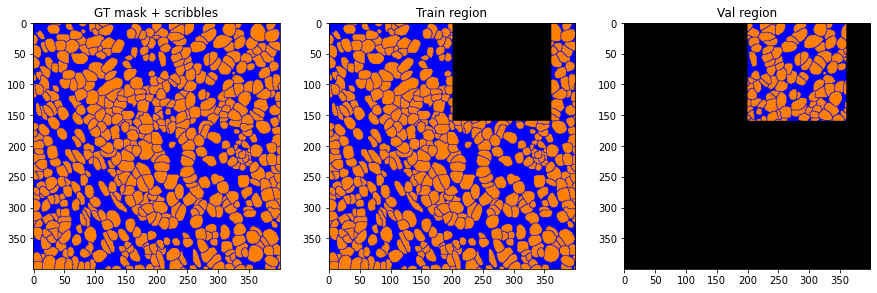

18 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_18.npz', 'image_18']
image_18_1task1class_35images_fulllabels.npz
6836 17 36
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_18_1task1class_35images_fulllabels.npz


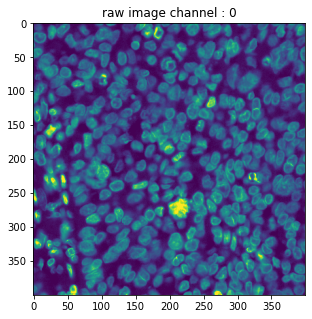

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


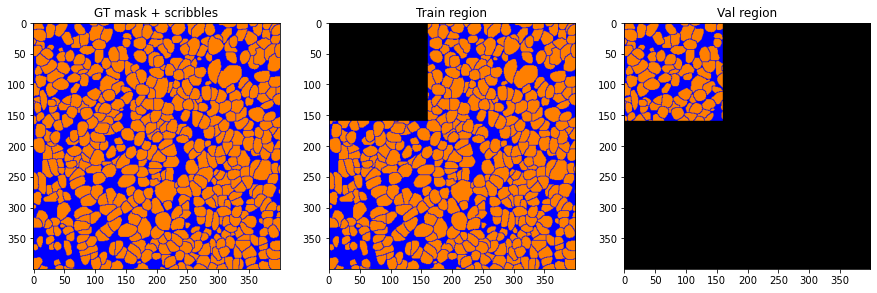

19 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_19.npz', 'image_19']
image_19_1task1class_35images_fulllabels.npz
92900 232 100
72 232 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_19_1task1class_35images_fulllabels.npz


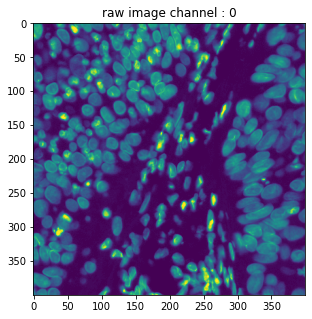

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


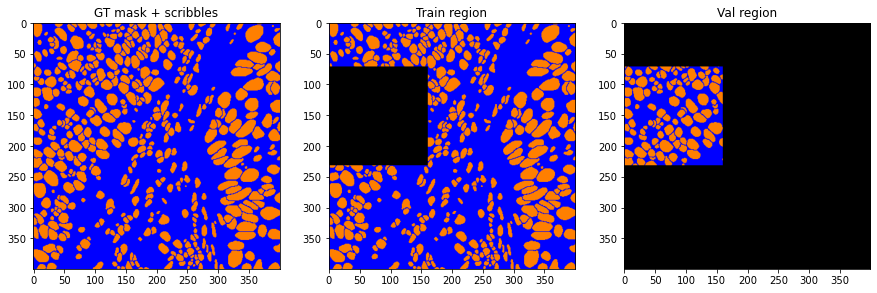

20 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_20.npz', 'image_20']
image_20_1task1class_35images_fulllabels.npz
104720 261 320
101 261 160 320
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_20_1task1class_35images_fulllabels.npz


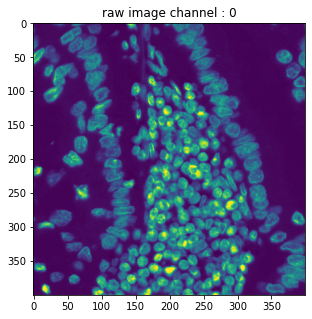

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


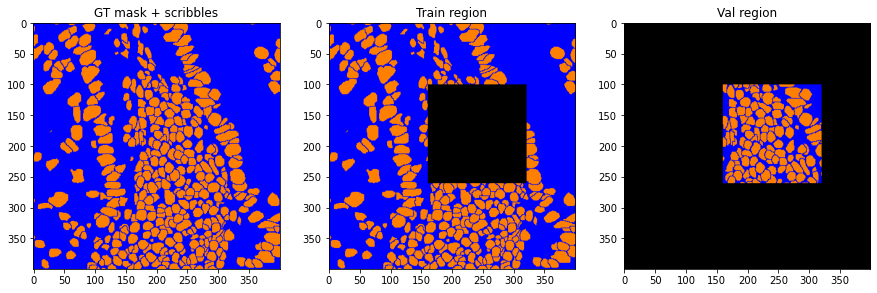

21 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_21.npz', 'image_21']
image_21_1task1class_35images_fulllabels.npz
133118 332 318
172 332 158 318
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_21_1task1class_35images_fulllabels.npz


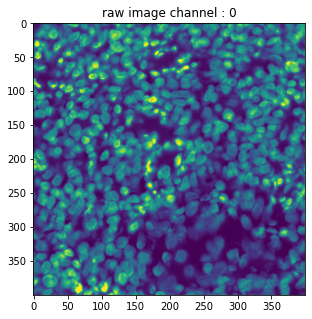

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


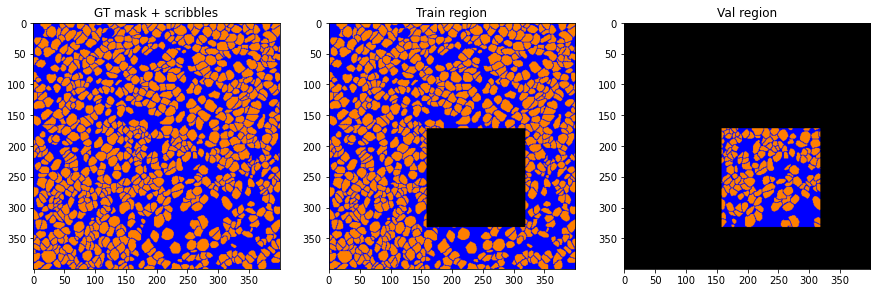

22 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_22.npz', 'image_22']
image_22_1task1class_35images_fulllabels.npz
32741 81 341
0 160 181 341
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_22_1task1class_35images_fulllabels.npz


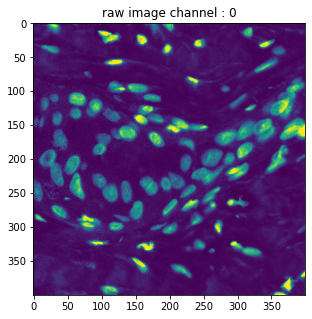

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


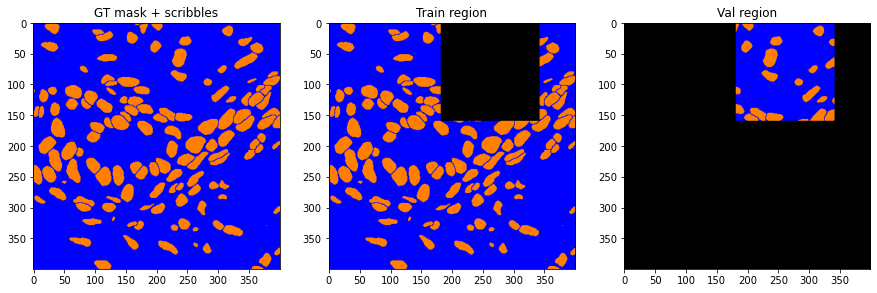

23 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_23.npz', 'image_23']
image_23_1task1class_35images_fulllabels.npz
44143 110 143
0 160 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_23_1task1class_35images_fulllabels.npz


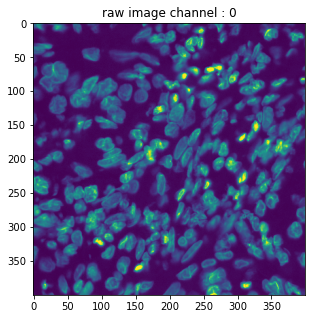

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


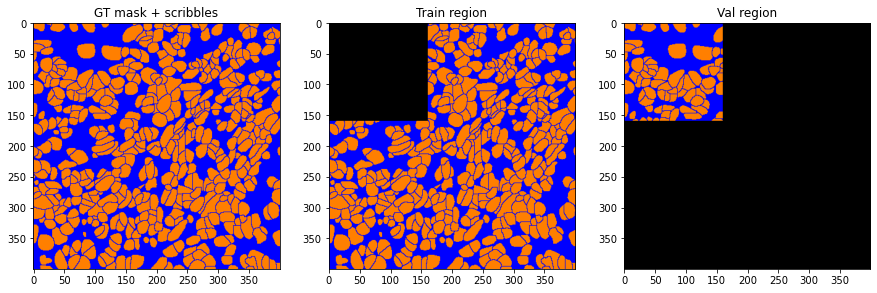

24 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_24.npz', 'image_24']
image_24_1task1class_35images_fulllabels.npz
72038 180 38
20 180 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_24_1task1class_35images_fulllabels.npz


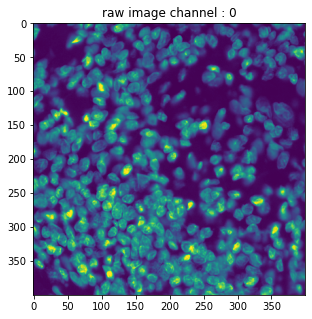

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


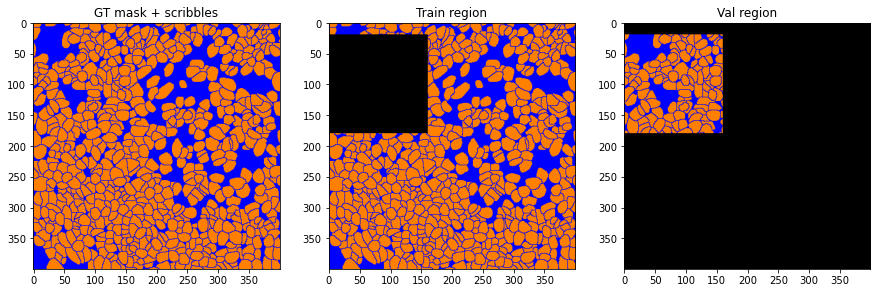

25 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_25.npz', 'image_25']
image_25_1task1class_35images_fulllabels.npz
116037 290 37
130 290 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_25_1task1class_35images_fulllabels.npz


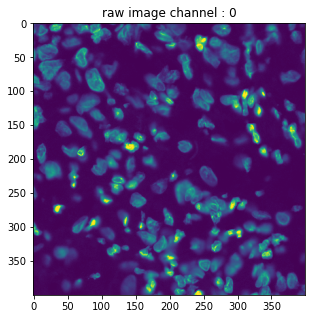

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


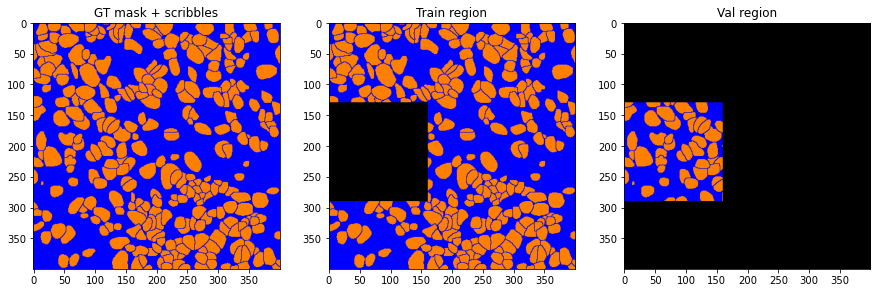

26 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_26.npz', 'image_26']
image_26_1task1class_35images_fulllabels.npz
15849 39 249
0 160 89 249
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_26_1task1class_35images_fulllabels.npz


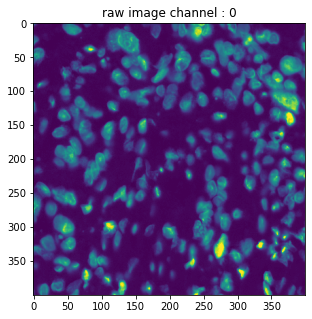

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


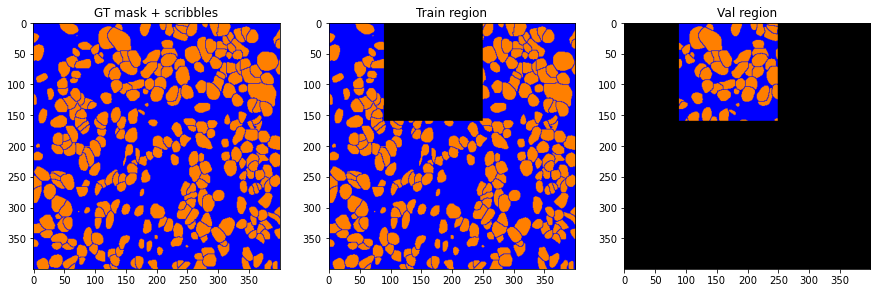

27 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_27.npz', 'image_27']
image_27_1task1class_35images_fulllabels.npz
123510 308 310
148 308 150 310
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_27_1task1class_35images_fulllabels.npz


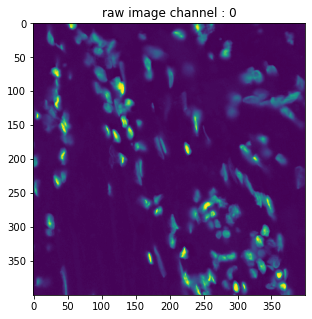

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


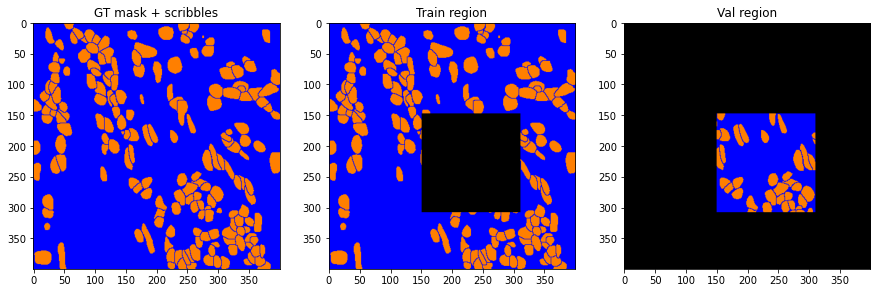

28 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_28.npz', 'image_28']
image_28_1task1class_35images_fulllabels.npz
50793 126 393
0 160 233 393
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_28_1task1class_35images_fulllabels.npz


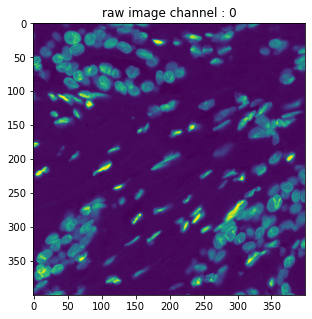

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


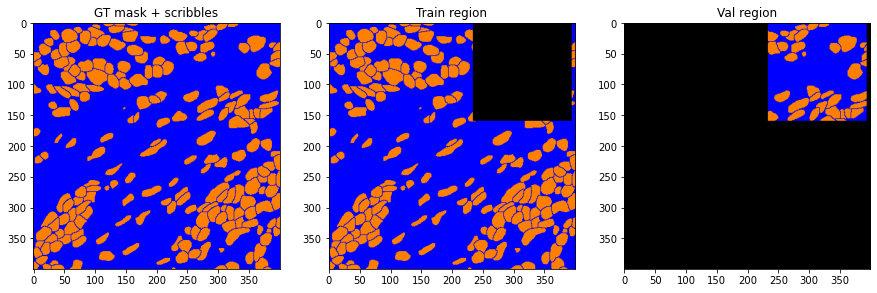

29 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_29.npz', 'image_29']
image_29_1task1class_35images_fulllabels.npz
3440 8 240
0 160 80 240
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_29_1task1class_35images_fulllabels.npz


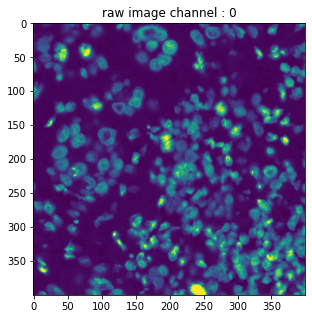

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


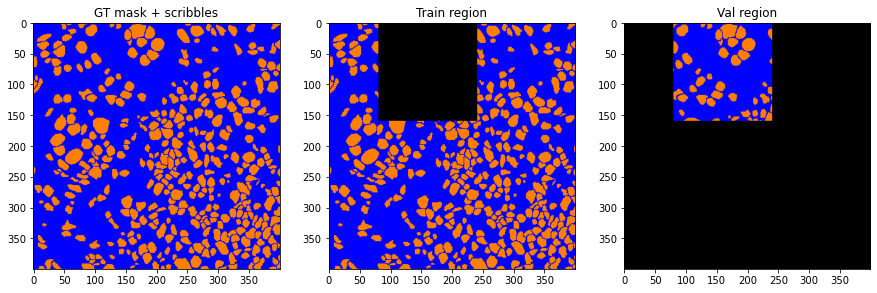

30 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_30.npz', 'image_30']
image_30_1task1class_35images_fulllabels.npz
27095 67 295
0 160 135 295
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_30_1task1class_35images_fulllabels.npz


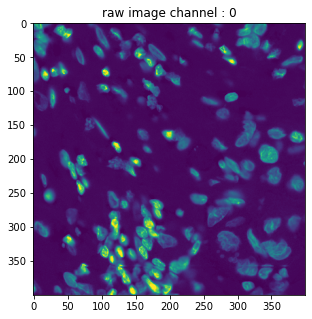

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


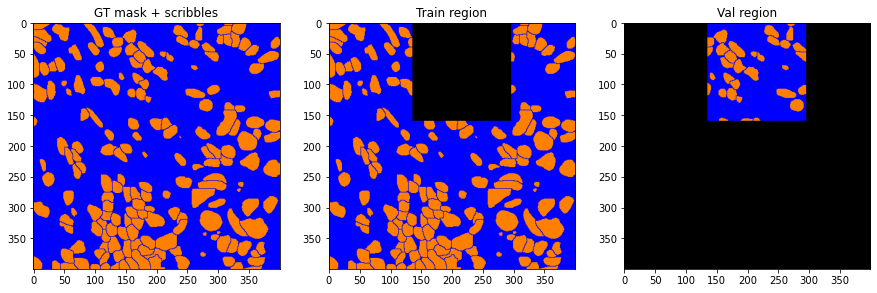

31 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_31.npz', 'image_31']
image_31_1task1class_35images_fulllabels.npz
95636 239 36
79 239 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_31_1task1class_35images_fulllabels.npz


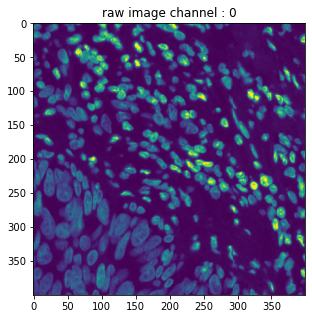

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


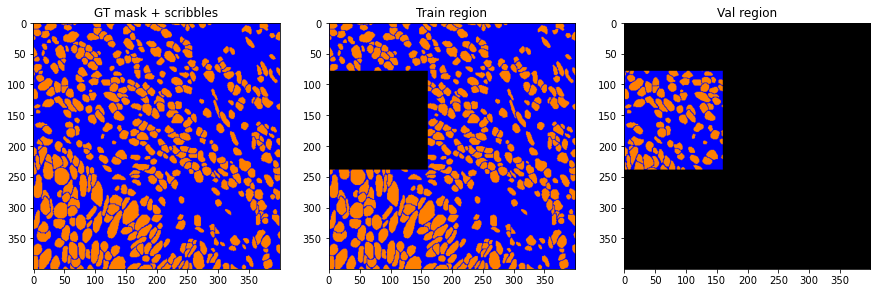

32 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_32.npz', 'image_32']
image_32_1task1class_35images_fulllabels.npz
149741 374 141
214 374 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_32_1task1class_35images_fulllabels.npz


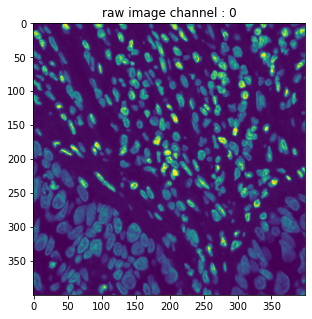

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


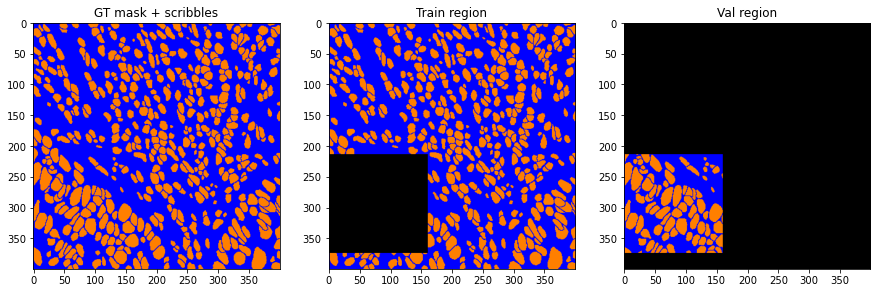

33 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_33.npz', 'image_33']
image_33_1task1class_35images_fulllabels.npz
114682 286 282
126 286 122 282
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_33_1task1class_35images_fulllabels.npz


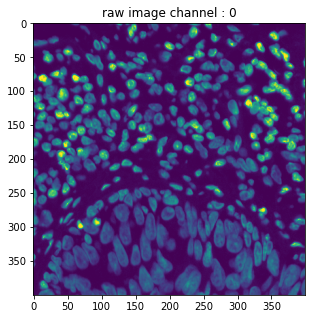

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


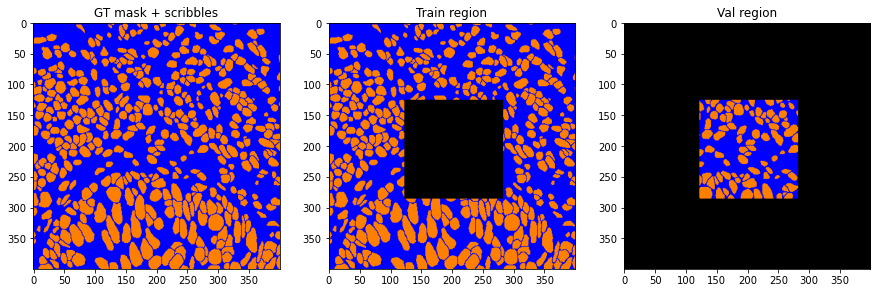

34 ['/nadeem_lab/Gunjan/data/impartial/Vectra1CH/', 'image_34.npz', 'image_34']
image_34_1task1class_35images_fulllabels.npz
76486 191 86
31 191 0 160
check unique values scribbles : [0. 1.]
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/image_34_1task1class_35images_fulllabels.npz


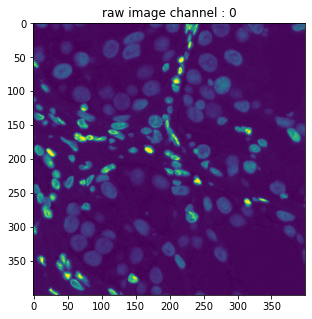

 task 0 ; classes : [0]
check sum of scribbles on same class (=1 or 0) : [1.]


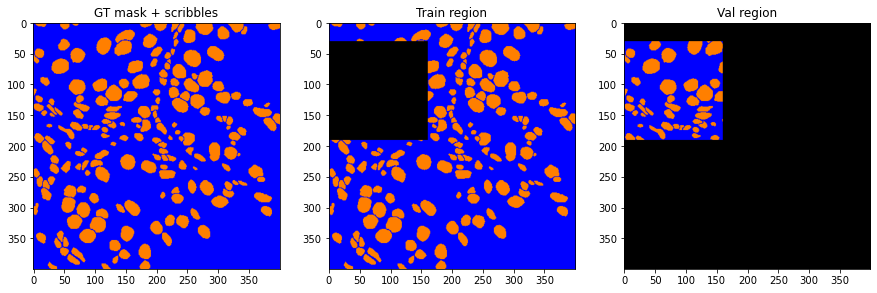

In [14]:
## Save scribbles
val_perc = 0.4
import copy
from csbdeep.utils import normalize

np.random.seed(9)
np.random.seed(44)


files_train_list = copy.deepcopy(files_train_list_aux)
for i in range(len(files_train_list)):
    
    image = X_train_list[i]
    image = X_train_list[i][...,np.newaxis]
    label_gt = Y_gt_train_ch0_list[i][...,np.newaxis] 
    scribbles_ch = [Y_out_ch0_list[i]]
    
    
    ### save scribbles file name
    print(i,files_train_list[i])
    name_save = files_train_list[i][1].split('.')[0] + '_1task1class_35images_fulllabels.npz'
    print(name_save)
    files_train_list[i].extend([name_save])
    
    ### save number of labels with scribbles per channel
    for ch in np.arange(len(scribbles_ch)):
        label_ch = label_gt[...,ch]
        s_ch = scribbles_ch[ch]

        #nlabels with scribbles
        label_wscribble = np.unique(label_ch[s_ch[...,0]>0].flatten())
        nscribbles = label_wscribble.shape[0]
        nlabels = np.unique(label_ch[label_ch>0]).shape[0]
        pixels_scribbled_TP = np.round(100*np.sum(s_ch[...,0]>0)/ (np.sum(label_ch>0)),2)
        pixels_scribbled_TN = np.round(100*np.sum(s_ch[...,1]>0)/ (np.sum(label_ch==0)),2)
        files_train_list[i].extend([int(nlabels),int(nscribbles),
                                    label_wscribble,pixels_scribbled_TP,pixels_scribbled_TN])
    
    ### Define classification tasks and their scribbles
    tasks_classes = {'0':[0]}
    
    scribble = None
    for tasks in tasks_classes.keys():
        start_task = True
        for ch in tasks_classes[tasks]:
            
            s_ch = scribbles_ch[ch]
            
            label_ch = np.array(label_gt)
            label_ch[...,ch] = 0
            label_ch = label_ch[...,tasks_classes[tasks]]
            label_ch[label_ch>0] = 1
            label_ch = np.sum(label_ch,-1)
            
            if start_task:
                background = np.array(s_ch[...,1])*(1-label_ch) + 0 #make sure no foreground is set as background
                scribble_task = np.array(s_ch[...,0])[...,np.newaxis] + 0
                start_task = False
            else:
                background += np.array(s_ch[...,1])*(1-label_ch) #make sure no foreground is set as background
                scribble_task = np.concatenate([scribble_task, np.array(s_ch[...,0])[...,np.newaxis]],axis = -1)
                
        scribble_task = np.concatenate([scribble_task,background[...,np.newaxis]],axis = -1)
        scribble_task[scribble_task>0] = 1
        
        if scribble is None:
            scribble = np.array(scribble_task)
        else:
            scribble = np.concatenate([scribble,scribble_task],axis = -1)
                
    
    ### validation sample region mask ###
    region_val_size = [int(image.shape[0] * val_perc/2),int(image.shape[1] * val_perc/2)] #validation region
    mask_scribbles = np.sum(scribble,axis = -1)
    mask_scribbles[mask_scribbles>0] = 1
    from scipy import ndimage
    mask_scribbles = ndimage.convolve(mask_scribbles, np.ones([5,5]), mode='constant', cval=0.0)
    #remove borders
#     mask_scribbles[-region_val_size[0]:,:] = 0
#     mask_scribbles[:,-region_val_size[1]:] = 0
#     mask_scribbles[0:region_val_size[0],:] = 0
#     mask_scribbles[:,0:region_val_size[1]] = 0
    val_center = np.random.multinomial(1, mask_scribbles.flatten()/np.sum(mask_scribbles.flatten()), size=1).flatten()
    ix_center = np.argmax(val_center)
    ix_row = int(np.floor(ix_center/image.shape[1]))
    ix_col = int(ix_center - ix_row * image.shape[1])
    print(ix_center,ix_row,ix_col)
    
    row_low = np.maximum(ix_row-region_val_size[0],0)
    row_high = np.minimum(row_low+region_val_size[0],image.shape[0])
    row_low = np.maximum(row_high - 2*region_val_size[0],0)
    row_high = np.minimum(row_low+ 2*region_val_size[0],image.shape[0])
    
    col_low = np.maximum(ix_col-region_val_size[1],0)
    col_high = np.minimum(col_low+region_val_size[1],image.shape[1])
    col_low = np.maximum(col_high - 2*region_val_size[1],0)
    col_high = np.minimum(col_low+2*region_val_size[1],image.shape[1])
    print(row_low,row_high,col_low,col_high)
    
    validation_mask = np.zeros([image.shape[0],image.shape[1]])
    validation_mask[row_low:row_high,
                    col_low:col_high] = 1
#     validation_mask[ix_row-region_val_size[0]:ix_row+region_val_size[0],
#                     ix_col-region_val_size[1]:ix_col+region_val_size[1]] = 1
    
    ## saving
    print('check unique values scribbles :',np.unique(scribble))
    print(files_train_list[i][0]+name_save)
    np.savez(files_train_list[i][0] + name_save, scribble=scribble, val_mask = validation_mask)
    
    ############################################# Plots #############################################
    #plot input channels
    plt.figure(figsize=(10,5))
    ix = 0
    for ch in range(image.shape[-1]):
        image_plot = normalize(image[...,ch], pmin=1, pmax=99.8, clip = True)
        plt.subplot(1,image.shape[-1],ix + 1)
        ix += 1
        plt.title('raw image channel : '+ str(ch))
        plt.imshow(image_plot)
    plt.show()
    
    itask = 0
    for tasks in tasks_classes.keys():
        classes_lists = tasks_classes[tasks]
        print(' task '+ str(tasks) + ' ; classes :',classes_lists)
        
        label_ch = np.array(label_gt[...,classes_lists])
        label_ch[label_ch>0] = 1
        label_ch = np.sum(label_ch*(np.arange(len(classes_lists))+1)[np.newaxis,np.newaxis,:],-1)
        print('check sum of scribbles on same class (=1 or 0) :',
              np.unique(np.sum(scribble[...,itask:itask+len(classes_lists)+1],-1)))
        
        aux = np.zeros([image_plot.shape[0],image_plot.shape[1],3])
        aux[...,1] = label_ch*0.5/len(classes_lists)
        aux[...,0] = np.sum(scribble[...,itask:itask+len(classes_lists)],-1)
        aux[...,2] = scribble[...,itask+len(classes_lists)]
        itask += len(classes_lists)+1
        
        plt.figure(figsize=(15,5))
        plt.subplot(1,3,1)
        plt.title('GT mask + scribbles')
        plt.imshow(aux)

        plt.subplot(1,3,2)
        plt.title('Train region')
        plt.imshow(aux*(1-validation_mask[...,np.newaxis]))

        plt.subplot(1,3,3)
        plt.title('Val region')
        plt.imshow(aux*validation_mask[...,np.newaxis])
        plt.show()
    # break

In [15]:
columns = ['input_dir','input_file','prefix','scribble_file']
for ch in np.arange(1):
    for col in ['total_labels','scribble_labels',
                'label_with_scribble','perc_pixels_scribbles_TP','perc_pixels_scribbles_TN']:
        columns.append(col + '_class' + str(ch))

pd_scribbles = pd.DataFrame(data=files_train_list, columns=columns)

for task in tasks_classes.keys():
    pd_scribbles['gt_index_task' + task] = [tasks_classes[task] for _ in range(len(pd_scribbles))]

print('Saving in: ')
namefile = data_dir + 'files_1task1class_35images_scribble_train_fulllabels.csv'
print(namefile)
pd_scribbles.to_csv(namefile, index=None)

pd_scribbles

Saving in: 
/nadeem_lab/Gunjan/data/impartial/Vectra1CH/files_1task1class_35images_scribble_train_fulllabels.csv


,input_dir,input_file,prefix,scribble_file,total_labels_class0,scribble_labels_class0,label_with_scribble_class0,perc_pixels_scribbles_TP_class0,perc_pixels_scribbles_TN_class0,gt_index_task0
0,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_0.npz,image_0,image_0_1task1class_35images_fulllabels.npz,569,569,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
1,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_1.npz,image_1,image_1_1task1class_35images_fulllabels.npz,637,637,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
2,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_2.npz,image_2,image_2_1task1class_35images_fulllabels.npz,771,771,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
3,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_3.npz,image_3,image_3_1task1class_35images_fulllabels.npz,827,827,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
4,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_4.npz,image_4,image_4_1task1class_35images_fulllabels.npz,646,646,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
5,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_5.npz,image_5,image_5_1task1class_35images_fulllabels.npz,684,684,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
6,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_6.npz,image_6,image_6_1task1class_35images_fulllabels.npz,416,416,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
7,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_7.npz,image_7,image_7_1task1class_35images_fulllabels.npz,514,514,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
8,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_8.npz,image_8,image_8_1task1class_35images_fulllabels.npz,256,256,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
9,/nadeem_lab/Gunjan/data/impartial/Vectra1CH/,image_9.npz,image_9,image_9_1task1class_35images_fulllabels.npz,330,330,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",100.0,100.0,[0]
